In [10]:
import pandas as pd
import numpy as np
import seaborn as sns
import glob
import matplotlib.pyplot as plt
from matplotlib.image import imread, imsave
import pickle as pkl
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold


In [11]:
vit_pred = pd.read_csv('./KIc/Model/vit/vit_large_patch32_224_Kfold_seed42_oof_df.csv')
vit_pred['Id'] = vit_pred['Id'].apply(lambda x: int(str(x)[1:]))
f = open("./Mototake_Analysis/VGG+GP/Y_pred_rational_seed42.pkl","rb")
plot_Y_rational42 = pkl.load(f)
f.close() 
true_kic_vgg_gau = pd.Series(plot_Y_rational42[0][3])  
predicted_kic_vgg_gau = pd.Series(plot_Y_rational42[1][3])  

vit_pred = vit_pred.rename(columns={'preds':'Vit_pred'})
vit_pred['VGG_pred'] = predicted_kic_vgg_gau

pred = vit_pred.sort_values(by='Id').reset_index(drop=True)
pred['vit_diff'] = abs(pred['Vit_pred'] - pred['KIc'])
pred['vgg_diff'] = abs(pred['VGG_pred'] - pred['KIc'])
pred['dif'] = pred['vgg_diff'] - pred['vit_diff']
pred

,Id,KIc,file_path,fold,Vit_pred,VGG_pred,vit_diff,vgg_diff,dif
0,95,3.55,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,3.371745,2.916221,0.178255,0.633779,0.455524
1,96,3.74,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,3.690316,3.079149,0.049684,0.660851,0.611167
2,97,3.68,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,0,3.736940,3.460305,0.056940,0.219695,0.162755
3,98,3.72,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,3,3.701220,3.360445,0.018780,0.359555,0.340775
4,99,3.61,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,3.482813,3.252522,0.127187,0.357478,0.230291
...,...,...,...,...,...,...,...,...,...
765,1836,3.77,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,0,3.839266,3.715750,0.069266,0.054250,-0.015016
766,1837,3.67,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,0,3.850743,3.626415,0.180743,0.043585,-0.137158
767,1838,3.80,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,3.806178,3.695061,0.006178,0.104939,0.098761
768,1839,3.88,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,3.919823,3.753590,0.039823,0.126410,0.086587


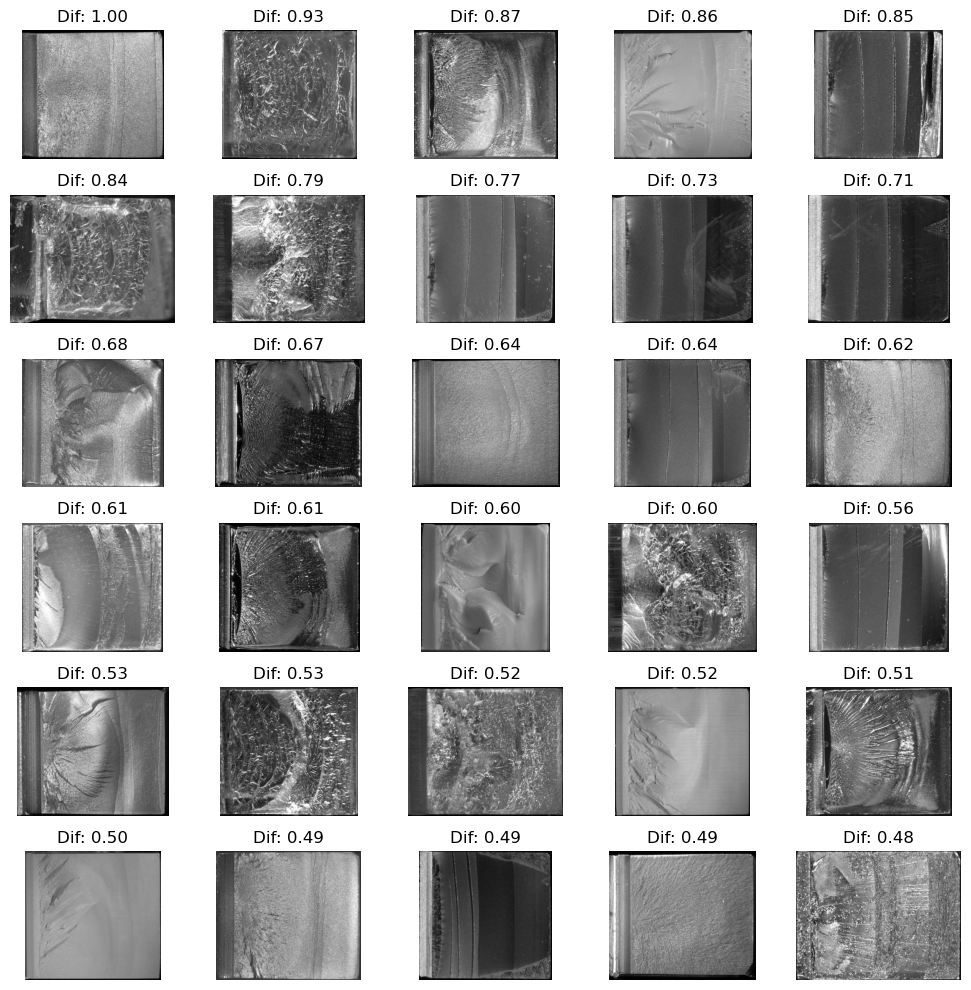

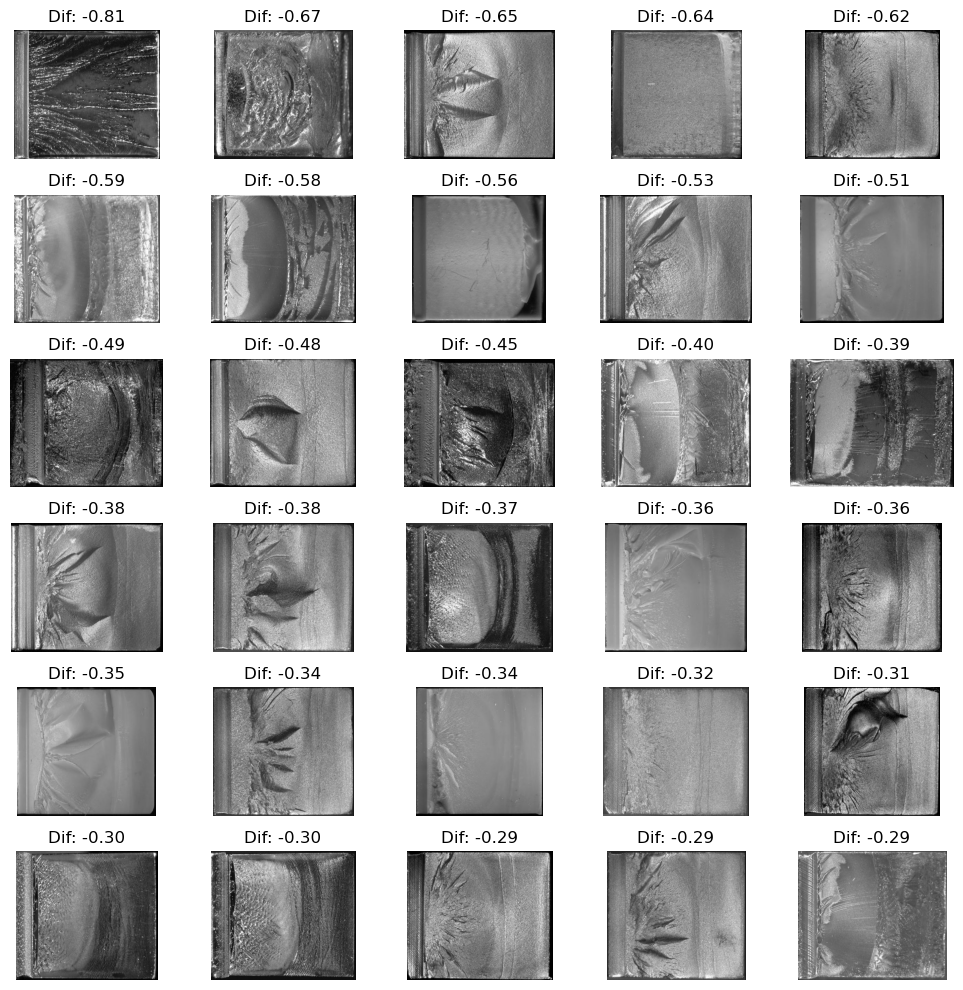

In [9]:
import matplotlib.pyplot as plt
import cv2

n=30
# predのdifが大きい画像n枚を取得
df_large_dif = pred.nlargest(n, 'dif')
large_dif_images = df_large_dif['Id'].values.tolist()

# predのdifが小さい画像n枚を取得
df_small_dif = pred.nsmallest(n, 'dif')
small_dif_images = df_small_dif['Id'].values.tolist()

# 2行5列のグリッドで描画
fig, axes = plt.subplots(n//5, 5, figsize=(10, 10))

# predのdifが大きい画像を描画
for i, image_path in enumerate(large_dif_images):
    ax = axes[i // 5, i % 5]
    image = imread('/home/yamanaka/Estimate_KIc_with_ViT/Mototake_Analysis/VGG+GP/imagedata/1' + str(image_path).zfill(5) + '.jpg')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax.imshow(image)
    ax.axis('off')
    ax.set_title(f"Dif: {df_large_dif.iloc[i]['dif']:.2f}")

plt.tight_layout()
plt.show()

# 2行5列のグリッドで描画
fig, axes = plt.subplots(n//5, 5, figsize=(10, 10))

# predのdifが小さい画像を描画
for i, image_path in enumerate(small_dif_images):
    ax = axes[i // 5, i % 5]
    image = imread('/home/yamanaka/Estimate_KIc_with_ViT/Mototake_Analysis/VGG+GP/imagedata/1' + str(image_path).zfill(5) + '.jpg')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax.imshow(image)
    ax.axis('off')
    ax.set_title(f"Dif: {df_small_dif.iloc[i]['dif']:.2f}")

plt.tight_layout()
plt.show()


In [66]:
# !pip install openpyxl
kind=pd.read_excel('./KIc/A_FractureToughness_TensileTest.xlsx')

In [67]:
kind

,ID,材料名,グレード名,試験名,試験方法,試験規格,試験装置,試験片,試験片形状,試験片規格,...,曲げ強さ,曲げ弾性率,アイゾット衝撃強さ(23℃),アイゾット衝撃強さ(-30℃),ロックウェル硬さ,線膨張係数,比重,性質,用途,コメント1
0,1,PC,NF2000U,引張,NaN,ISO 527-1及びISO 527-2,5567 30kNf,NaN,ダンベル型,ISO 527-2/1A,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
1,2,PC,NF2000U,引張,NaN,ISO 527-1及びISO 527-2,5567 30kNf,NaN,ダンベル型,ISO 527-2/1A,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
2,3,PC,NF2000U,引張,NaN,ISO 527-1及びISO 527-2,5567 30kNf,NaN,ダンベル型,ISO 527-2/1A,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
3,4,PC,NF2000U,引張,NaN,ISO 527-1及びISO 527-2,5567 30kNf,NaN,ダンベル型,ISO 527-2/1A,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
4,5,PC,NF2000U,引張,NaN,ISO 527-1及びISO 527-2,5567 30kNf,NaN,ダンベル型,ISO 527-2/1A,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1827,1836,PC,NF2000U,破壊靭性,NaN,ASTM D5045-93,サーボパルサーEHF-ED50KN-20Ｌ,NaN,SENB,NaN,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
1828,1837,PC,NF2000U,破壊靭性,NaN,ASTM D5045-93,サーボパルサーEHF-ED50KN-20Ｌ,NaN,SENB,NaN,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
1829,1838,PC,NF2000U,破壊靭性,NaN,ASTM D5045-93,サーボパルサーEHF-ED50KN-20Ｌ,NaN,SENB,NaN,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN
1830,1839,PC,NF2000U,破壊靭性,NaN,ASTM D5045-93,サーボパルサーEHF-ED50KN-20Ｌ,NaN,SENB,NaN,...,80.4～90.2,2.2,740～980,NaN,M60～M70,6～7,1.2,NaN,NaN,NaN


In [68]:
df_new=pd.merge(pred, kind[['ID', '材料名']], left_on='Id', right_on='ID', how='left')
df_new

,Id,KIc,file_path,fold,Vit_pred,VGG_pred,vit_diff,vgg_diff,dif,ID,材料名
0,95,3.55,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,3.371745,2.916221,0.178255,0.633779,0.455524,95,PC
1,96,3.74,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,3.690316,3.079149,0.049684,0.660851,0.611167,96,PC
2,97,3.68,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,0,3.736940,3.460305,0.056940,0.219695,0.162755,97,PC
3,98,3.72,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,3,3.701220,3.360445,0.018780,0.359555,0.340775,98,PC
4,99,3.61,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,3.482813,3.252522,0.127187,0.357478,0.230291,99,PC
...,...,...,...,...,...,...,...,...,...,...,...
765,1836,3.77,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,0,3.839266,3.715750,0.069266,0.054250,-0.015016,1836,PC
766,1837,3.67,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,0,3.850743,3.626415,0.180743,0.043585,-0.137158,1837,PC
767,1838,3.80,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,3.806178,3.695061,0.006178,0.104939,0.098761,1838,PC
768,1839,3.88,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,3.919823,3.753590,0.039823,0.126410,0.086587,1839,PC


/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/events.py:82: UserWarning: Glyph 26448 (\N{CJK UNIFIED IDEOGRAPH-6750}) missing from current font.
  func(*args, **kwargs)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/events.py:82: UserWarning: Glyph 26009 (\N{CJK UNIFIED IDEOGRAPH-6599}) missing from current font.
  func(*args, **kwargs)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/events.py:82: UserWarning: Glyph 21517 (\N{CJK UNIFIED IDEOGRAPH-540D}) missing from current font.
  func(*args, **kwargs)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26448 (\N{CJK UNIFIED IDEOGRAPH-6750}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning

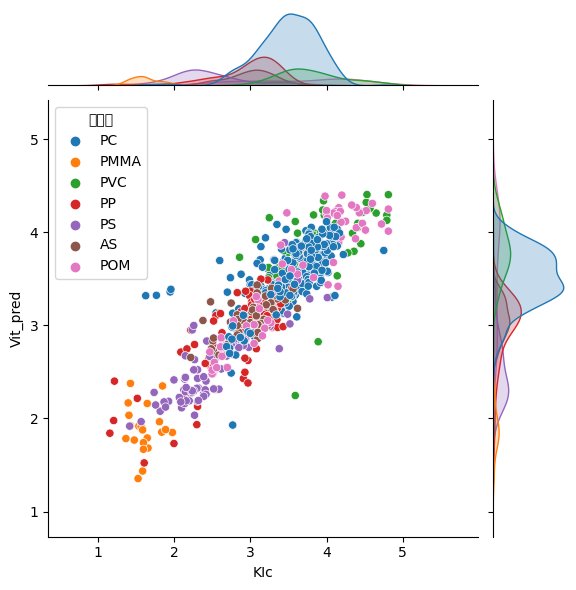

In [69]:
sns.jointplot(x='KIc', y='Vit_pred', data=df_new, hue='材料名')

In [70]:
polymer_list=['PMMA', 'PS', 'PP', 'AS', 'PC', 'PVC', 'POM']

In [71]:
import collections
kind_polymer = collections.Counter(df_new['材料名'])
kind_polymer

Counter({'PC': 346,
         'PP': 118,
         'PVC': 85,
         'PS': 80,
         'POM': 62,
         'AS': 58,
         'PMMA': 21})

In [72]:
# ID_list=[229, 230, 232, 242, 244, 393, 615, 798, 835, 1624,
#         818, 1634, 593, 368, 555, 237, 576, 262, 736, 801]
ID_list=pred.sort_values(by='dif', ascending=False).head(10)['Id'].values.tolist() + pred.sort_values(by='dif', ascending=False).tail(10)['Id'].values.tolist()
ID_list

[800,
 860,
 576,
 312,
 249,
 839,
 813,
 240,
 243,
 244,
 428,
 1627,
 329,
 1807,
 184,
 739,
 328,
 1652,
 818,
 1756]

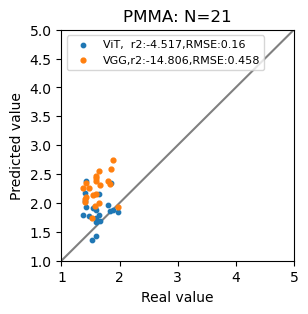

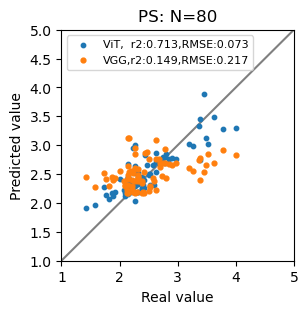

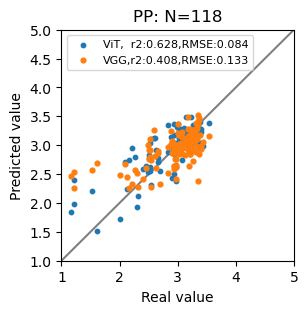

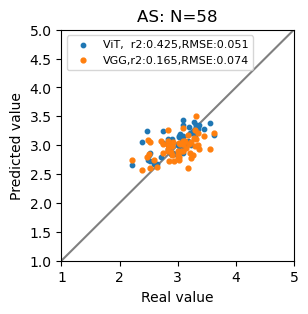

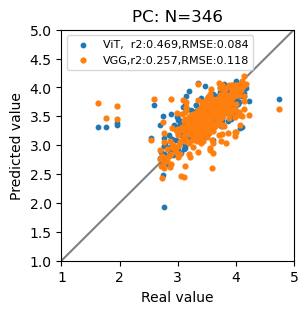

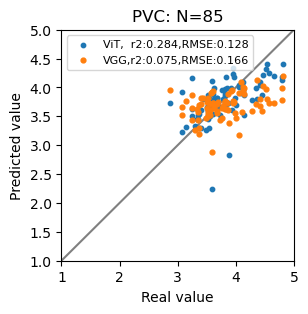

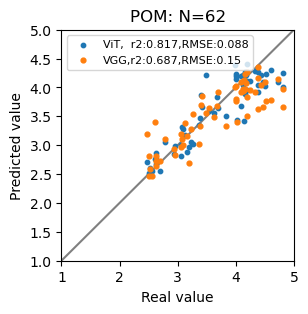

In [73]:
for polymer in polymer_list:
    plt.figure(figsize=(3,3))
    plt.scatter(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['Vit_pred'], zorder=2, s=10,
                label='ViT,  r2:'+str(round(r2_score(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['Vit_pred']),3))
               +',RMSE:'+str(round(mean_squared_error(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['Vit_pred']),3)))
    plt.scatter(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['VGG_pred'], zorder=3, s=12,
                label='VGG,r2:'+str(round(r2_score(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['VGG_pred']),3))
               +',RMSE:'+str(round(mean_squared_error(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['VGG_pred']),3)))
    plt.plot([1,5],[1,5], c='grey', zorder=1)
    plt.xlim(1,5)
    plt.ylim(1,5)
    plt.xlabel('Real value')
    plt.ylabel('Predicted value')
    plt.title(polymer+': N='+str(kind_polymer[polymer]))
    plt.legend(fontsize=8, loc='upper left')
    plt.show()

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

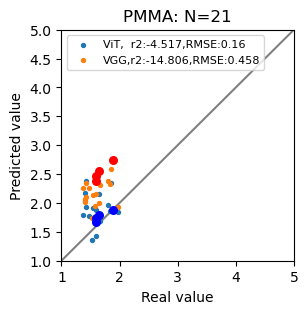

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

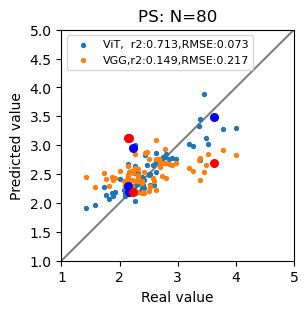

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

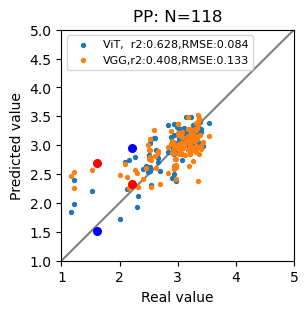

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

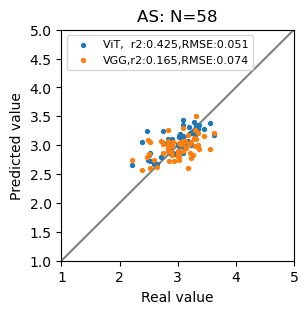

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

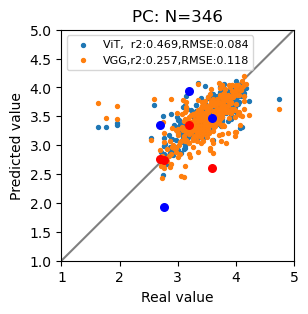

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

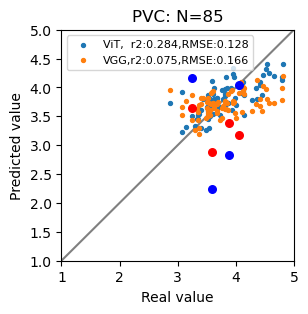

/tmp/ipykernel_1450900/3502794553.py:9: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
/tmp/ipykernel_1450900/3502794553.py:10: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list e

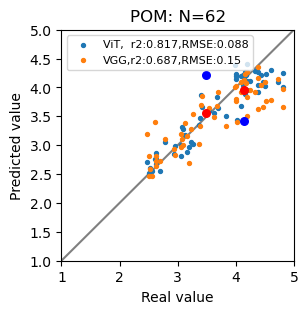

In [74]:
for polymer in polymer_list:
    plt.figure(figsize=(3,3))
    plt.scatter(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['Vit_pred'], zorder=2, s=8,
                label='ViT,  r2:'+str(round(r2_score(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['Vit_pred']),3))
               +',RMSE:'+str(round(mean_squared_error(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['Vit_pred']),3)))
    plt.scatter(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['VGG_pred'], zorder=3, s=8,
                label='VGG,r2:'+str(round(r2_score(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['VGG_pred']),3))
               +',RMSE:'+str(round(mean_squared_error(df_new[df_new['材料名']==polymer]['KIc'], df_new[df_new['材料名']==polymer]['VGG_pred']),3)))
    plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['Vit_pred'], zorder=4, s=30, c='b')
    plt.scatter(df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['KIc'], df_new[(df_new['材料名']==polymer)&[True if ID_inter in ID_list else False for ID_inter in df_new['ID']]]['VGG_pred'], zorder=4, s=30, c='r')
    plt.plot([1,5],[1,5], c='grey', zorder=1)
    plt.xlim(1,5)
    plt.ylim(1,5)
    plt.xlabel('Real value')
    plt.ylabel('Predicted value')
    plt.title(polymer+': N='+str(kind_polymer[polymer]))
    plt.legend(fontsize=8, loc='upper left')
    plt.show()

/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/seaborn/utils.py:80

/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/events.py:82: UserWarning: Glyph 26448 (\N{CJK UNIFIED IDEOGRAPH-6750}) missing from current font.
  func(*args, **kwargs)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/events.py:82: UserWarning: Glyph 26009 (\N{CJK UNIFIED IDEOGRAPH-6599}) missing from current font.
  func(*args, **kwargs)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/events.py:82: UserWarning: Glyph 21517 (\N{CJK UNIFIED IDEOGRAPH-540D}) missing from current font.
  func(*args, **kwargs)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 26448 (\N{CJK UNIFIED IDEOGRAPH-6750}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/yamanaka/.pyenv/versions/anaconda3-2023.03/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning

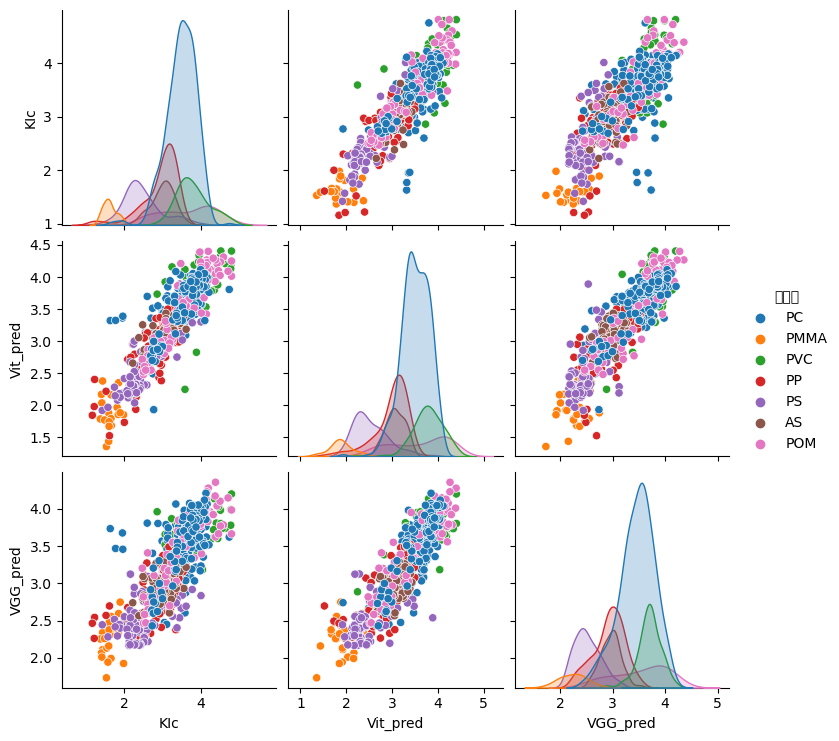

In [75]:
sns.pairplot(data=df_new[['KIc', 'Vit_pred', 'VGG_pred', '材料名']], hue='材料名')

In [76]:
df_new[['Id', 'KIc', 'Vit_pred', 'VGG_pred', '材料名']]

,Id,KIc,Vit_pred,VGG_pred,材料名
0,95,3.55,3.371745,2.916221,PC
1,96,3.74,3.690316,3.079149,PC
2,97,3.68,3.736940,3.460305,PC
3,98,3.72,3.701220,3.360445,PC
4,99,3.61,3.482813,3.252522,PC
...,...,...,...,...,...
765,1836,3.77,3.839266,3.715750,PC
766,1837,3.67,3.850743,3.626415,PC
767,1838,3.80,3.806178,3.695061,PC
768,1839,3.88,3.919823,3.753590,PC


In [77]:
polymer_list=['PMMA', 'PS', 'PP', 'AS', 'PC', 'PVC', 'POM']

In [78]:
df_inter=df_new[df_new['材料名']==polymer_list[0]].sort_values('KIc')
df_inter

,Id,KIc,file_path,fold,Vit_pred,VGG_pred,vit_diff,vgg_diff,dif,ID,材料名
126,233,1.37,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,1.783594,2.252549,0.413594,0.882549,0.468956,233,PMMA
124,231,1.40,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,2.166874,2.065522,0.766874,0.665522,-0.101352,231,PMMA
125,232,1.41,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,2,2.033991,2.010059,0.623991,0.600059,-0.023931,232,PMMA
122,229,1.43,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,3,2.375788,2.338798,0.945788,0.908798,-0.036990,229,PMMA
123,230,1.43,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,3,1.922083,2.110197,0.492083,0.680197,0.188114,230,PMMA
135,242,1.48,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,1,1.767524,2.258473,0.287524,0.778473,0.490949,242,PMMA
127,234,1.53,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,3,1.353938,1.732060,0.176063,0.202060,0.025997,234,PMMA
128,235,1.54,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,4,1.916338,2.130801,0.376338,0.590801,0.214463,235,PMMA
131,238,1.57,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,1,1.910915,1.942325,0.340915,0.372325,0.031411,238,PMMA
132,239,1.59,/home/yamanaka/Estimate_KIc_with_ViT/Mototake_...,1,1.877004,2.437490,0.287004,0.847490,0.560486,239,PMMA


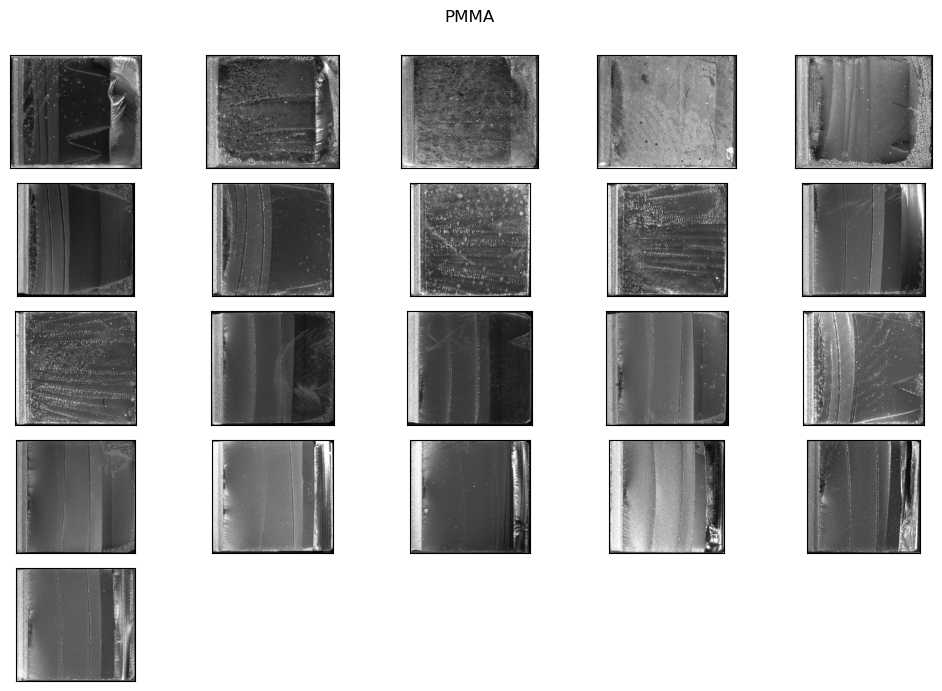

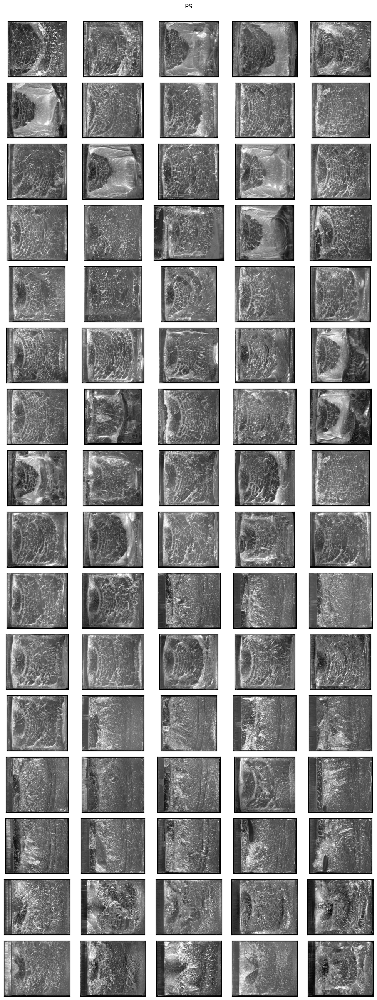

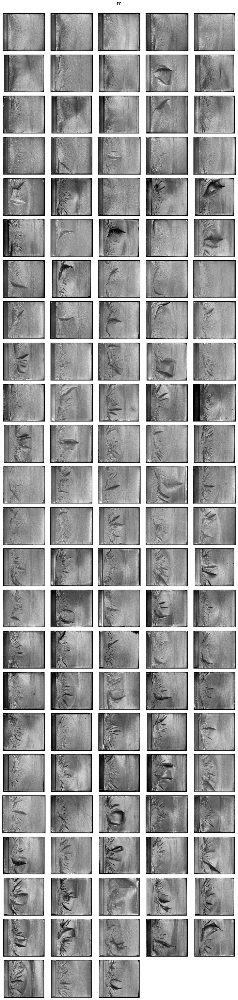

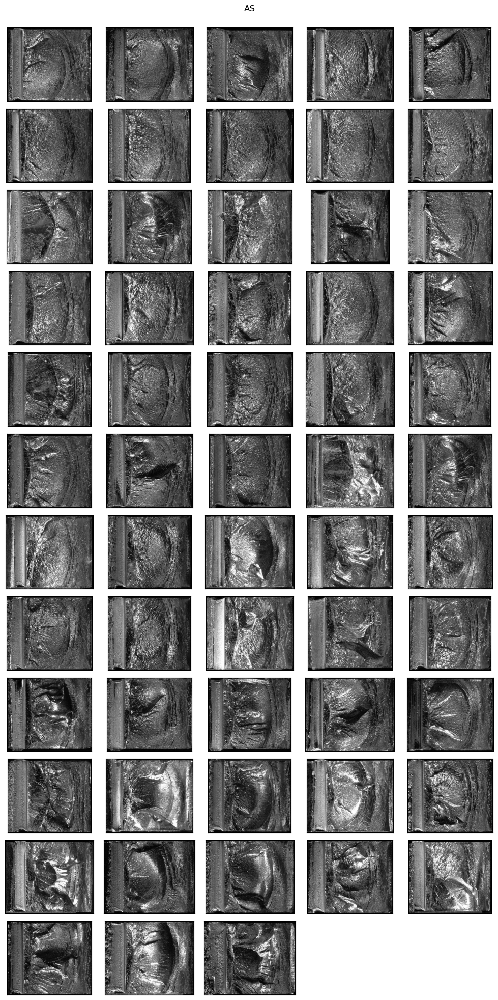

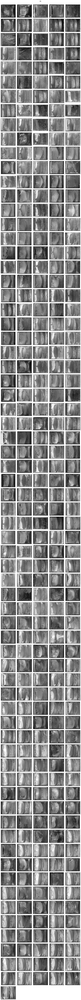

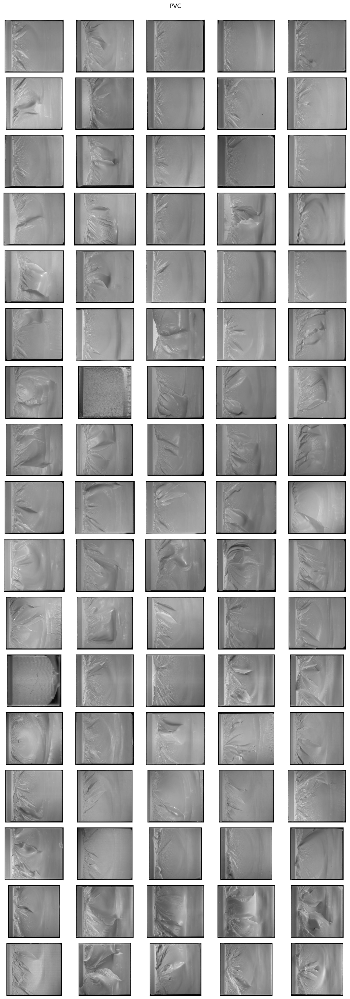

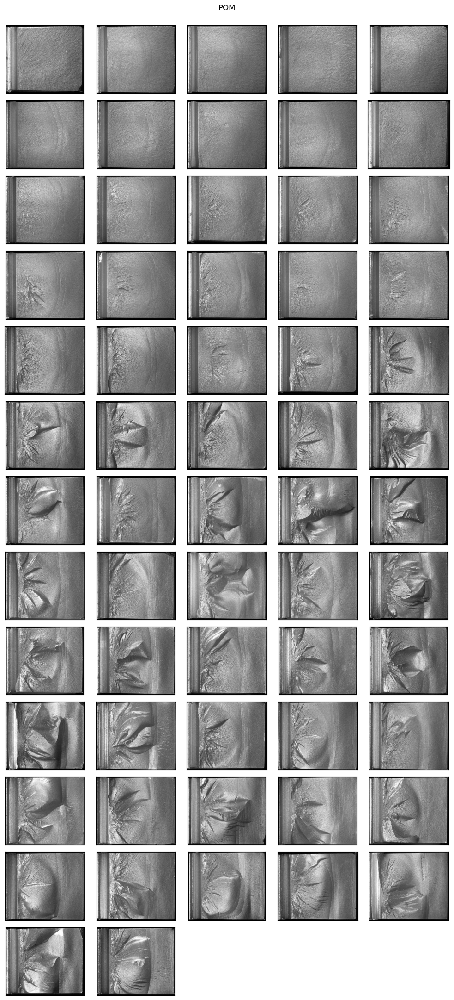

In [85]:
num_col=5

for j in range(len(polymer_list)):
    df_inter=df_new[df_new['材料名']==polymer_list[j]].sort_values('KIc')
    plt.figure(figsize=(10,int(len(df_inter)*1.8/num_col)))
    plt.suptitle(str(polymer_list[j]))
    for i,ID in enumerate(df_inter['ID']):
        plt.subplot(int(len(df_inter)/num_col)+1,num_col,i+1)
        # plt.imshow(imread(glob.glob('/Users/yoshi/Desktop/破断面/sum/'+str(ID)+'*')[0]))
        plt.imshow(cv2.imread(glob.glob('/home/yamanaka/Estimate_KIc_with_ViT/Mototake_Analysis/VGG+GP/imagedata/1' + str(ID).zfill(5) + '.jpg')[0]))
        plt.tick_params(labelbottom=False, labelleft=False, labelright=False, labeltop=False)
        plt.tick_params(bottom=False, left=False, right=False, top=False)
    plt.tight_layout(rect=[0,0,1,0.98])
    plt.show()